<h1>Brand Slogans Notebook #4<span class="tocSkip"></span></h1>

In this part of the project, I focus on gender analysis. 

The notebook contains such concepts as:

- Gender extraction with the use of the genderize API,
- EDA of the gender part of the dataset,
- Feature scaling,
- Exploration of the Language used in the slogans of the brands lead by men and women.

Some extra visualisations can be found in Tableau:
- https://public.tableau.com/profile/agnieszka2824#!/vizhome/GenderAnalysis-BrandSlogans/GenderAnalysis?publish=yes

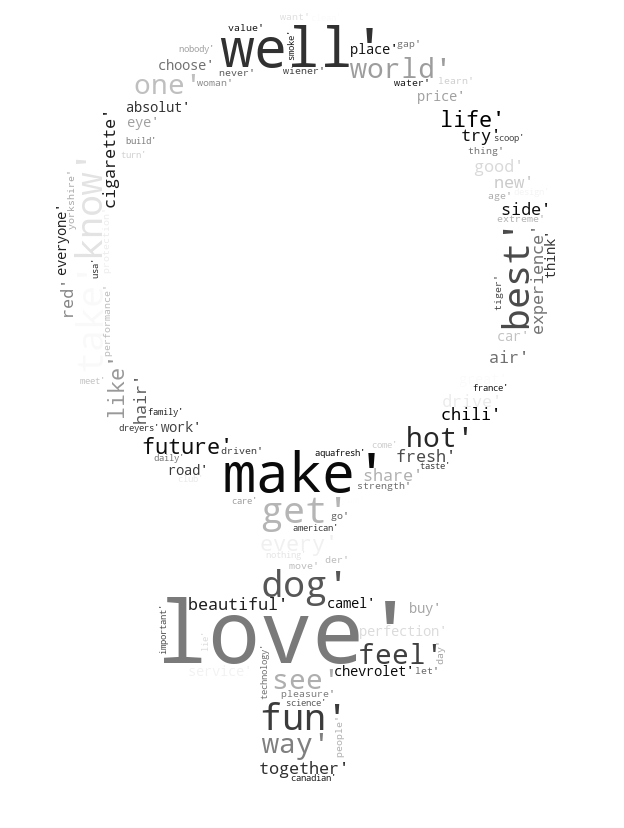


<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Import-the-CEO-and-the-Slogans-datasets-and-merge-them-on-Brand-column" data-toc-modified-id="Import-the-CEO-and-the-Slogans-datasets-and-merge-them-on-Brand-column-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Import the CEO and the Slogans datasets and merge them on Brand column</a></span><ul class="toc-item"><li><span><a href="#Cleaning-the-dataset:" data-toc-modified-id="Cleaning-the-dataset:-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Cleaning the dataset:</a></span></li></ul></li><li><span><a href="#Gender-analysis" data-toc-modified-id="Gender-analysis-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Gender analysis</a></span><ul class="toc-item"><li><span><a href="#Gender-distribution---plots" data-toc-modified-id="Gender-distribution---plots-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Gender distribution - plots</a></span></li><li><span><a href="#Gender-distribution-by-country---plot" data-toc-modified-id="Gender-distribution-by-country---plot-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Gender distribution by country - plot</a></span><ul class="toc-item"><li><span><a href="#Feature-scaling:-MinMaxScaler-on-GENDER/COUNTRY-relation:" data-toc-modified-id="Feature-scaling:-MinMaxScaler-on-GENDER/COUNTRY-relation:-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Feature scaling: MinMaxScaler on GENDER/COUNTRY relation:</a></span></li></ul></li><li><span><a href="#Gender-by-category" data-toc-modified-id="Gender-by-category-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Gender by category</a></span><ul class="toc-item"><li><span><a href="#Feature-Scaling---MinMaxScaler-on-GENDER/CATEGORY-relation:" data-toc-modified-id="Feature-Scaling---MinMaxScaler-on-GENDER/CATEGORY-relation:-2.3.1"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>Feature Scaling - MinMaxScaler on GENDER/CATEGORY relation:</a></span></li></ul></li><li><span><a href="#Wordcloud---most-used-words-in-companies-lead-by-women-and-men" data-toc-modified-id="Wordcloud---most-used-words-in-companies-lead-by-women-and-men-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Wordcloud - most used words in companies lead by women and men</a></span><ul class="toc-item"><li><span><a href="#Expanding-and-cleaning-the-slogans:" data-toc-modified-id="Expanding-and-cleaning-the-slogans:-2.4.1"><span class="toc-item-num">2.4.1&nbsp;&nbsp;</span>Expanding and cleaning the slogans:</a></span></li><li><span><a href="#Removing-stopwords,-punctuation,-etc" data-toc-modified-id="Removing-stopwords,-punctuation,-etc-2.4.2"><span class="toc-item-num">2.4.2&nbsp;&nbsp;</span>Removing stopwords, punctuation, etc</a></span></li><li><span><a href="#Tokenization:" data-toc-modified-id="Tokenization:-2.4.3"><span class="toc-item-num">2.4.3&nbsp;&nbsp;</span>Tokenization:</a></span></li><li><span><a href="#Splitting-to-male-and-female-datasets:" data-toc-modified-id="Splitting-to-male-and-female-datasets:-2.4.4"><span class="toc-item-num">2.4.4&nbsp;&nbsp;</span>Splitting to male and female datasets:</a></span></li><li><span><a href="#Most-common-words" data-toc-modified-id="Most-common-words-2.4.5"><span class="toc-item-num">2.4.5&nbsp;&nbsp;</span>Most common words</a></span><ul class="toc-item"><li><span><a href="#Men" data-toc-modified-id="Men-2.4.5.1"><span class="toc-item-num">2.4.5.1&nbsp;&nbsp;</span>Men</a></span></li><li><span><a href="#Women" data-toc-modified-id="Women-2.4.5.2"><span class="toc-item-num">2.4.5.2&nbsp;&nbsp;</span>Women</a></span></li></ul></li></ul></li></ul></li></ul></div>

In [1]:
import pandas as pd
pd.options.mode.chained_assignment = None

import numpy as np
import math

import matplotlib as mpl
from matplotlib import pyplot as plt
import seaborn as sns
import matplotlib
import plotly.express as px
import matplotlib.pylab as pylab
import missingno as msno

import warnings
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", message="numpy.dtype size changed")
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.tools as tls
import plotly.graph_objs as go
import plotly
import plotly.figure_factory as ff
plt.rcParams['figure.dpi'] = 300

import base64
import os

# Plotly imports
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
from PIL import Image


# Other imports
from collections import Counter
import requests
import imageio
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from matplotlib import pyplot as plt

# text processing libraries
import re
import string
import nltk
from nltk.corpus import stopwords

from wordcloud import WordCloud, STOPWORDS

from nltk.stem import WordNetLemmatizer

import en_core_web_sm
nlp = en_core_web_sm.load()


from nltk.corpus import stopwords, wordnet

from nltk.probability import FreqDist


import sys

sys.path.insert(0, '/Users/agieen/Downloads/AllWomen/_functions_')

from Functions_data_preprocessing_NLP import *
from fx_NLP import *

# Import the CEO and the Slogans datasets and merge them on Brand column

In [2]:
ceo = pd.read_csv('/Users/agieen/Downloads/AllWomen/_Final_Project/datasets/list of ceos complete.csv', delimiter=';')
ceo.head()

,Brand,Country,Executive
0,Audi,Germany,Markus Duesmann
1,Avon,UK,Angela Cretu
2,Arby's,USA,Paul Brown
3,Adidas,Germany,Kasper Rorsted
4,Allstate,USA,Thomas J. Wilson


In [3]:
ceo.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 849 entries, 0 to 848
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Brand      849 non-null    object
 1   Country    639 non-null    object
 2   Executive  836 non-null    object
dtypes: object(3)
memory usage: 20.0+ KB


In [4]:
# Extracting the First Name of the CEOs for the gender determination:

ceo["FirstName"] = ceo["Executive"].str.split(" ").str.get(0)
ceo = ceo.reset_index()




In [5]:
ceo.drop('index', axis=1)

,Brand,Country,Executive,FirstName
0,Audi,Germany,Markus Duesmann,Markus
1,Avon,UK,Angela Cretu,Angela
2,Arby's,USA,Paul Brown,Paul
3,Adidas,Germany,Kasper Rorsted,Kasper
4,Allstate,USA,Thomas J. Wilson,Thomas
...,...,...,...,...
844,WWE,NaN,Vince McMahon,Vince
845,Yum China,NaN,Joey Wat,Joey
846,Yum! Brands,NaN,Greg Creed,Greg
847,Zoetis,NaN,Kristin Peck,Kristin


In [6]:
from genderize import Genderize

import os
directory = '../output'

if not os.path.exists(directory):
    os.makedirs(directory)

In [7]:
gender = Genderize().get(list(ceo.FirstName))

In [8]:
gender = pd.DataFrame(gender).iloc[:,0:3]
gender.columns = ['FirstName', 'gender', 'probability']

In [9]:
gender

,FirstName,gender,probability
0,Markus,male,1.00
1,Angela,female,0.99
2,Paul,male,0.99
3,Kasper,male,0.98
4,Thomas,male,0.99
...,...,...,...
844,Vince,male,0.98
845,Joey,male,0.83
846,Greg,male,0.99
847,Kristin,female,0.93


In [10]:
# merging the gender df with the CEOs:

ceo_gender = gender.merge(ceo)

In [11]:
ceo_gender.duplicated().sum()

3146

In [12]:
ceo_gender.drop_duplicates(inplace=True)

In [13]:
ceo_gender.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 836 entries, 0 to 3981
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   FirstName    836 non-null    object 
 1   gender       823 non-null    object 
 2   probability  836 non-null    float64
 3   index        836 non-null    int64  
 4   Brand        836 non-null    object 
 5   Country      626 non-null    object 
 6   Executive    836 non-null    object 
dtypes: float64(1), int64(1), object(5)
memory usage: 52.2+ KB


In [14]:
ceo_gender.gender.unique()

array(['male', 'female', None], dtype=object)

In [15]:
ceo_gender[ceo_gender.gender.isna()]


,FirstName,gender,probability,index,Brand,Country,Executive
2473,Anheuser-Busch,None,0.0,95,Bass Brewery,UK,Anheuser-Busch InBev
3267,Véronique,None,0.0,190,Dannon Yogurt,France,Véronique Penchienati-Bosetta
3268,Véronique,None,0.0,605,Volvic,France,Véronique Penchienati-Bosetta
3348,Greg Carmichael,None,0.0,240,Fifth Third Banking,USA,Greg Carmichael
3798,Ysuo,None,0.0,469,Olympus Corporation,Japan,Ysuo Takeuchi
3821,Debra Perelman,None,0.0,523,Revlon,USA,Debra Perelman
3832,J.,None,0.0,554,STAPLES,USA,J. Alexander Douglas
3833,J.,None,0.0,812,Sonic Corporation,NaN,J. Clifford Hudson
3864,G.,None,0.0,617,Converse,USA,G. Scott Uzzell
3865,G.,None,0.0,719,Dr. Reddy's,NaN,G. V. Prasad


As some of the first names were either not recognized or they had just the 1st letter of the name, we should fill them in:
Missing values:
    
Apart from Véronique Penchienati-Bosetta and Debra Perelman, all unrecognized CEOs are male

In [16]:
ceo_gender.loc[ceo_gender.Executive == "Véronique Penchienati-Bosetta", "gender"] = "female"


In [17]:
ceo_gender.loc[3821, "gender"] = "female"


In [18]:
ceo_gender.fillna(value = 'male', inplace=True)

In [19]:
ceo_gender.gender.unique()


array(['male', 'female'], dtype=object)

In [20]:
ceo_gender.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 836 entries, 0 to 3981
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   FirstName    836 non-null    object 
 1   gender       836 non-null    object 
 2   probability  836 non-null    float64
 3   index        836 non-null    int64  
 4   Brand        836 non-null    object 
 5   Country      836 non-null    object 
 6   Executive    836 non-null    object 
dtypes: float64(1), int64(1), object(5)
memory usage: 84.5+ KB


In [21]:
ceo_gender = ceo_gender.drop('probability', axis=1)

In [22]:
ceo_gender.reset_index(inplace=True)
ceo_gender

,level_0,FirstName,gender,index,Brand,Country,Executive
0,0,Markus,male,0,Audi,Germany,Markus Duesmann
1,1,Angela,female,1,Avon,UK,Angela Cretu
2,2,Paul,male,2,Arby's,USA,Paul Brown
3,3,Paul,male,67,Blue Bell Ice Cream,USA,Paul Kruse
4,4,Paul,male,85,Bega Cheese,UK,Paul van Heerwaarden
...,...,...,...,...,...,...,...
831,3977,Ann,female,839,Warner Bros.,male,Ann Sarnoff
832,3978,Abidali,male,843,Wipro Technologies Limited,male,Abidali Neemuchwala
833,3979,Vince,male,844,WWE,male,Vince McMahon
834,3980,Joey,male,845,Yum China,male,Joey Wat


In [23]:
ceo_gender = ceo_gender.drop('FirstName', axis=1)

In [24]:
ceo_gender.drop('level_0', axis=1, inplace=True)

In [25]:
ceo_gender

,gender,index,Brand,Country,Executive
0,male,0,Audi,Germany,Markus Duesmann
1,female,1,Avon,UK,Angela Cretu
2,male,2,Arby's,USA,Paul Brown
3,male,67,Blue Bell Ice Cream,USA,Paul Kruse
4,male,85,Bega Cheese,UK,Paul van Heerwaarden
...,...,...,...,...,...
831,female,839,Warner Bros.,male,Ann Sarnoff
832,male,843,Wipro Technologies Limited,male,Abidali Neemuchwala
833,male,844,WWE,male,Vince McMahon
834,male,845,Yum China,male,Joey Wat


In [26]:
#reordering the columns:

ceo_gender = ceo_gender[['Brand', 'Country', 'Executive', 'gender']]
ceo_gender.head()



,Brand,Country,Executive,gender
0,Audi,Germany,Markus Duesmann,male
1,Avon,UK,Angela Cretu,female
2,Arby's,USA,Paul Brown,male
3,Blue Bell Ice Cream,USA,Paul Kruse,male
4,Bega Cheese,UK,Paul van Heerwaarden,male


In [27]:
ceo_gender_ = ceo_gender.to_csv('List_CEOs_with_gender.csv')

In [28]:
#import slogans

slogans = pd.read_csv('/Users/agieen/Downloads/AllWomen/_Final_Project/datasets/Slogans_with_cat_split.csv', index_col=0)
slogans.head()

,Brand,Slogan,Country,Continent,main_cat,sub_cat1
0,Audi,Never Follow.\nKeeping ahead through technolog...,Germany,Europe,Automotive,NaN
1,Apple,Byte into an Apple. (Late 1970s)\nSimplicity i...,USA,North America,Technology and Tech Services,NaN
2,American Airlines,The new American is arriving.\nBe yourself. No...,USA,North America,Airline,NaN
3,Avon,"The company for women.\nWe make it easy, You m...",UK,Europe,Cosmetics and self-care,NaN
4,Accenture,"High Performance, Delivered.\nGo on, be a Tige...",Ireland,Europe,Technology and Tech Services,NaN


In [29]:
slogans.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 781 entries, 0 to 780
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Brand      781 non-null    object
 1   Slogan     781 non-null    object
 2   Country    781 non-null    object
 3   Continent  781 non-null    object
 4   main_cat   781 non-null    object
 5   sub_cat1   146 non-null    object
dtypes: object(6)
memory usage: 42.7+ KB


In [30]:
ceo_gender.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 836 entries, 0 to 835
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Brand      836 non-null    object
 1   Country    836 non-null    object
 2   Executive  836 non-null    object
 3   gender     836 non-null    object
dtypes: object(4)
memory usage: 26.2+ KB


In [31]:
# merging the two datasets:

df = pd.merge(slogans, ceo_gender, how='outer', left_on ='Brand', right_on='Brand')
df.head()

,Brand,Slogan,Country_x,Continent,main_cat,sub_cat1,Country_y,Executive,gender
0,Audi,Never Follow.\nKeeping ahead through technolog...,Germany,Europe,Automotive,NaN,Germany,Markus Duesmann,male
1,Apple,Byte into an Apple. (Late 1970s)\nSimplicity i...,USA,North America,Technology and Tech Services,NaN,male,Tim Cook,male
2,American Airlines,The new American is arriving.\nBe yourself. No...,USA,North America,Airline,NaN,male,Doug Parker,male
3,Avon,"The company for women.\nWe make it easy, You m...",UK,Europe,Cosmetics and self-care,NaN,UK,Angela Cretu,female
4,Accenture,"High Performance, Delivered.\nGo on, be a Tige...",Ireland,Europe,Technology and Tech Services,NaN,male,Julie Sweet,female


In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 850 entries, 0 to 849
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Brand      850 non-null    object
 1   Slogan     781 non-null    object
 2   Country_x  781 non-null    object
 3   Continent  781 non-null    object
 4   main_cat   781 non-null    object
 5   sub_cat1   146 non-null    object
 6   Country_y  837 non-null    object
 7   Executive  837 non-null    object
 8   gender     837 non-null    object
dtypes: object(9)
memory usage: 66.4+ KB


## Clean the dataset:

In [33]:
df.drop('Country_y', axis=1, inplace=True)

In [34]:
#df.iloc[760:800]

In [35]:
#renaming columns:

df.rename(columns={'Brand': 'brand',
                     'Slogan': 'slogan',
                     'Country_x': 'country',
                     'Continent': 'continent',
                     'main_cat': 'category',
                     'sub_cat1': 'sub_cat',
                     'Executive': 'executive',
                     'gender': 'gender', }, inplace=True)


In [36]:
#removing entries with no slogans:

df = df[df['slogan'].notna()]



In [37]:
# removing rows without CEOs:

df = df[df['executive'].notna()]



In [38]:
df.info()



<class 'pandas.core.frame.DataFrame'>
Int64Index: 768 entries, 0 to 780
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   brand      768 non-null    object
 1   slogan     768 non-null    object
 2   country    768 non-null    object
 3   continent  768 non-null    object
 4   category   768 non-null    object
 5   sub_cat    145 non-null    object
 6   executive  768 non-null    object
 7   gender     768 non-null    object
dtypes: object(8)
memory usage: 54.0+ KB


In [39]:
df.gender.value_counts()

male      662
female    106
Name: gender, dtype: int64

In [41]:
df.executive.duplicated().sum()

82

In [ ]:
#There are 82 names that are repeated in the dataset, it results from different brands 
#belonging to the same company or parent company.
#For better results, it's best to remove those brands from the analysis

In [42]:
gender = df.copy()

In [43]:
gender.drop_duplicates(subset=['executive'], inplace=True)


In [44]:
gender.executive.duplicated().sum()

0

In [45]:
gender.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 686 entries, 0 to 780
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   brand      686 non-null    object
 1   slogan     686 non-null    object
 2   country    686 non-null    object
 3   continent  686 non-null    object
 4   category   686 non-null    object
 5   sub_cat    125 non-null    object
 6   executive  686 non-null    object
 7   gender     686 non-null    object
dtypes: object(8)
memory usage: 48.2+ KB


In [ ]:
# We are left with 686 rows to do the analysis

In [46]:
gender_slogans = gender.to_csv('dataset_sloganswithgender.csv')

# Gender analysis

## Gender distribution - plots

In [47]:
gender.gender.value_counts()

male      593
female     93
Name: gender, dtype: int64

In [48]:
import plotly.express as px

fig = px.bar(gender, x='gender', color="gender", color_discrete_map={
                "male": "blue", "female": "magenta"},
            title="Gender distribution",
            category_orders={'gender': ['female', 'male']})
fig.show()

## Gender distribution by country - plot

In [49]:
male = gender[gender['gender'] == 'male']
country_count_male = male.groupby(['country'],
                                  as_index=True, sort=True).count()['gender']
country_count_male

country
Australia          18
Austria             2
Belgium             2
Bermuda             2
Canada             13
China               4
Czech Republic      2
Denmark             4
Finland             2
France             23
Germany            22
Hong Kong           3
India              20
Ireland             9
Italy              16
Jamaica             3
Japan              25
Kenya               1
Malaysia            4
Mexico              2
Monaco              1
Netherlands         8
New Zealand         2
Norway              1
Philippines         2
Russia              4
Singapore           2
South Africa        1
South Korea         7
Spain               3
Sri Lanka           1
Sweden              5
Switzerland        16
Taiwan              4
Tanzania            1
Thailand            3
UK                 55
USA               300
Name: gender, dtype: int64

In [50]:
country_count_male = country_count_male.reset_index()
country_count_male

,country,gender
0,Australia,18
1,Austria,2
2,Belgium,2
3,Bermuda,2
4,Canada,13
5,China,4
6,Czech Republic,2
7,Denmark,4
8,Finland,2
9,France,23


In [51]:
country_count_male.columns = ['country', 'male']

In [52]:
country_count_male

,country,male
0,Australia,18
1,Austria,2
2,Belgium,2
3,Bermuda,2
4,Canada,13
5,China,4
6,Czech Republic,2
7,Denmark,4
8,Finland,2
9,France,23


In [53]:
female = gender[gender['gender'] == 'female']
country_count_female = female.groupby(['country'],
                                      as_index=True, sort=True).count()['gender']
country_count_female

country
Australia          1
Canada             1
Czech Republic     1
France             4
Germany            3
Greece             2
India              1
Ireland            1
Japan              1
Luxembourg         1
Slovenia           1
Sri Lanka          1
Sweden             1
Taiwan             1
UK                 9
USA               64
Name: gender, dtype: int64

In [54]:
country_count_female = country_count_female.reset_index()
country_count_female.columns = ['country', 'female']
country_count_female

,country,female
0,Australia,1
1,Canada,1
2,Czech Republic,1
3,France,4
4,Germany,3
5,Greece,2
6,India,1
7,Ireland,1
8,Japan,1
9,Luxembourg,1


In [55]:
country_gender = pd.merge(country_count_male,country_count_female, how='outer', left_on ='country', right_on='country')
country_gender


,country,male,female
0,Australia,18.0,1.0
1,Austria,2.0,NaN
2,Belgium,2.0,NaN
3,Bermuda,2.0,NaN
4,Canada,13.0,1.0
5,China,4.0,NaN
6,Czech Republic,2.0,1.0
7,Denmark,4.0,NaN
8,Finland,2.0,NaN
9,France,23.0,4.0


In [56]:
import plotly.graph_objects as go

fig = go.Figure(go.Bar(x=country_gender.country, y=country_gender.male, name='Male'))
fig.add_trace(go.Bar(x=country_gender.country, y=country_gender.female, name='Female'))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array', 'categoryorder':'total descending'}, 
                 xaxis_tickangle=45)
fig.show()

In [ ]:
#Because the values in the USA are so high, it's hard to see the rest of the countries. Let's remove it from the plot
#to see the rest of the ocuntries better

In [57]:
country_gender_no_usa = country_gender.drop(index=37)

In [58]:
fig = go.Figure(go.Bar(x=country_gender_no_usa.country, y=country_gender_no_usa.male, name='Male'))
fig.add_trace(go.Bar(x=country_gender_no_usa.country, y=country_gender_no_usa.female, name='Female'))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array', 'categoryorder':'total descending'}, title='Gender by country',
                 xaxis_tickangle=45)
plotly.graph_objects.layout.Colorscale='vidris'
fig.show()


In [ ]:
#We can see that the representation of women in the dataset is not balanced, men constitue the majority in this case

### Feature scaling: MinMaxScaler on GENDER/COUNTRY relation:

For each value in a feature, MinMaxScaler subtracts the minimum value in the feature and then divides by the range. The range is the difference between the original maximum and original minimum.

MinMaxScaler preserves the shape of the original distribution. It doesn’t meaningfully change the information embedded in the original data.

The default range for the feature returned by MinMaxScaler is 0 to 1.

In [59]:
# changing NaN values to 0s:

country_gender['male'].fillna(0, inplace=True)
country_gender['female'].fillna(0, inplace=True)

In [60]:
# Load libraries
from pandas import set_option
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler, RobustScaler

In [61]:
# Initialise the Scaler 
scaler = MinMaxScaler() 

# Scale data 
country_gender_scaled = scaler.fit_transform(country_gender[['male','female']])


country_gender_scaled = pd.DataFrame(country_gender_scaled, columns=['male', 'female'])
country_gender_scaled.head()

,male,female
0,0.060000,0.015625
1,0.006667,0.000000
2,0.006667,0.000000
3,0.006667,0.000000
4,0.043333,0.015625


In [62]:
# Adding back the country

country_gender_scaled = pd.concat([country_gender_scaled, country_gender.country], axis=1)
country_gender_scaled.head()


,male,female,country
0,0.060000,0.015625,Australia
1,0.006667,0.000000,Austria
2,0.006667,0.000000,Belgium
3,0.006667,0.000000,Bermuda
4,0.043333,0.015625,Canada


In [63]:
fig = go.Figure(go.Bar(x=country_gender_scaled.country, y=country_gender_scaled.male, name='Male'))
fig.add_trace(go.Bar(x=country_gender_scaled.country, y=country_gender_scaled.female, name='Female'))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array', 'categoryorder':'total descending'}, title='Gender by country - scaled',
                 xaxis_tickangle=45)
plotly.graph_objects.layout.Colorscale='vidris'
fig.show()

## Gender by category

In [64]:
gend = gender.copy()

In [65]:
male = gend[gend['gender'] == 'male']
cat_count_m = male.groupby(['category'],as_index=True, sort=True)['category'].count()
cat_count_m

category
Airline                           32
Alcohol                           44
Apparel Accessories Footwear      61
Automotive                        56
Coffee                             4
Consumer goods                    32
Corporation                        3
Cosmetics and self-care           10
Cruise Line                       17
Electronics                       16
Energy/gas/petrol                  9
Financial services                56
Food and Beverage Industry        74
Hospitality                       13
Insurance                          7
Luxury goods                       1
Media                              4
Pharmaceutical                     7
Restaurants and Fast Food         26
Retail                            27
Services                          18
Technology and Tech Services      57
Tobacco                            4
e-commerce and online services    15
Name: category, dtype: int64

In [66]:
cat_count_m_ = pd.DataFrame(cat_count_m)

cat_count_m_.columns = ['male']

In [67]:

cat_count_m_.reset_index()

,category,male
0,Airline,32
1,Alcohol,44
2,Apparel Accessories Footwear,61
3,Automotive,56
4,Coffee,4
5,Consumer goods,32
6,Corporation,3
7,Cosmetics and self-care,10
8,Cruise Line,17
9,Electronics,16


In [68]:
fem = gend[gend['gender'] == 'female']
cat_count_female = fem.groupby(['category'],as_index=True, sort=True)['category'].count()
cat_count_female

category
Airline                          3
Alcohol                          4
Apparel Accessories Footwear     6
Automotive                       6
Consumer goods                   3
Corporation                      4
Cosmetics and self-care          6
Cruise Line                      3
Electronics                      1
Energy/gas/petrol                3
Financial services              10
Food and Beverage Industry      11
Insurance                        5
Pharmaceutical                   1
Restaurants and Fast Food        3
Retail                           5
Services                         7
Technology and Tech Services    10
Tobacco                          2
Name: category, dtype: int64

In [69]:
fem.head()

,brand,slogan,country,continent,category,sub_cat,executive,gender
3,Avon,"The company for women.\nWe make it easy, You m...",UK,Europe,Cosmetics and self-care,NaN,Angela Cretu,female
4,Accenture,"High Performance, Delivered.\nGo on, be a Tige...",Ireland,Europe,Technology and Tech Services,NaN,Julie Sweet,female
17,Absolut Vodka,Our Devotion to Perfection is Absolut.\nABSOLU...,Sweden,Europe,Alcohol,NaN,Anna Malmhake,female
18,Advanced Micro Devices,The future is fusion.\nTake your system to ext...,USA,North America,Technology and Tech Services,NaN,Lisa Su,female
21,Aquafresh,Feel good protection.\nAquafresh. Amazing.\nAq...,USA,North America,Cosmetics and self-care,NaN,Emma Walmsley,female


In [70]:
cat_count_f_ = pd.DataFrame(cat_count_female)

cat_count_f_.columns = ['female']

In [71]:
cat_count_f_.reset_index()

,category,female
0,Airline,3
1,Alcohol,4
2,Apparel Accessories Footwear,6
3,Automotive,6
4,Consumer goods,3
5,Corporation,4
6,Cosmetics and self-care,6
7,Cruise Line,3
8,Electronics,1
9,Energy/gas/petrol,3


In [72]:
categ_gender = pd.merge(cat_count_m_,cat_count_f_, how='outer', left_on ='category', right_on='category')
categ_gender


,male,female
category,,
Airline,32,3.0
Alcohol,44,4.0
Apparel Accessories Footwear,61,6.0
Automotive,56,6.0
Coffee,4,NaN
Consumer goods,32,3.0
Corporation,3,4.0
Cosmetics and self-care,10,6.0
Cruise Line,17,3.0


In [73]:
categ_gender.reset_index()

,category,male,female
0,Airline,32,3.0
1,Alcohol,44,4.0
2,Apparel Accessories Footwear,61,6.0
3,Automotive,56,6.0
4,Coffee,4,NaN
5,Consumer goods,32,3.0
6,Corporation,3,4.0
7,Cosmetics and self-care,10,6.0
8,Cruise Line,17,3.0
9,Electronics,16,1.0


In [74]:
categ_gender['male'].fillna(0, inplace=True)
categ_gender['female'].fillna(0, inplace=True)

In [75]:
categ_gender['male'] = categ_gender['male'].apply(np.int64)
categ_gender['female'] = categ_gender['female'].apply(np.int64)


In [76]:
categ_gender.reset_index(inplace=True)

In [77]:
categ_gender

,category,male,female
0,Airline,32,3
1,Alcohol,44,4
2,Apparel Accessories Footwear,61,6
3,Automotive,56,6
4,Coffee,4,0
5,Consumer goods,32,3
6,Corporation,3,4
7,Cosmetics and self-care,10,6
8,Cruise Line,17,3
9,Electronics,16,1


In [78]:
fig = go.Figure(go.Bar(x=categ_gender.category, y=categ_gender.male, name='Male'))
fig.add_trace(go.Bar(x=categ_gender.category, y=categ_gender.female, name='Female'))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array', 'categoryorder':'total descending'}, title='Gender by category')
fig.show()
fig.write_html("Gender_by_categ.html")

In [79]:

# Calculating Percentage
categ_gender['percent_f'] = (categ_gender['female'] / 
                  (categ_gender['male'] + categ_gender['female'])) * 100
  
categ_gender['percent_m'] = (categ_gender['male'] / 
                  (categ_gender['male'] + categ_gender['female'])) * 100
  
    

In [80]:
categ_gender = categ_gender.round(2)

In [81]:
#categ_gender.to_csv('categ_gender.csv')

In [82]:
categ_gender.sort_values(by='percent_f', ascending = False)

,category,male,female,percent_f,percent_m
6,Corporation,3,4,57.14,42.86
14,Insurance,7,5,41.67,58.33
7,Cosmetics and self-care,10,6,37.50,62.50
22,Tobacco,4,2,33.33,66.67
20,Services,18,7,28.00,72.00
10,Energy/gas/petrol,9,3,25.00,75.00
19,Retail,27,5,15.62,84.38
11,Financial services,56,10,15.15,84.85
8,Cruise Line,17,3,15.00,85.00
21,Technology and Tech Services,57,10,14.93,85.07



<h2>What can we get from those numbers?<span class="tocSkip"></span></h2>



- 4 out of 7 Corporations are managed by women (57%)
- 5 out of 12 Insurance companies are managed by women (42%)
- The percentage is also relatively high in categories such as Cosmetics & self-care (37.50%), Tobacco (33%) followed by Services (28%).
- In Hospitality and e-commerce, none of the companies in the dataset is lead by a woman
- The biggest category, Food and Beverage Industry, shows that out of 85 comapnies, only 11 are managed by women. A similar tendency can be observed in Alcohol companies - only 8% in this case 
- Surprisingly, Apparel, Accessories and Footwear are also mostly managed by men, with only 9% of women on Executive positions.

We have to remember that the dataset shows only the leading position of each company and doesn't include other, like designers, creative directors, founders, etc.

### Feature Scaling - MinMaxScaler on GENDER/CATEGORY relation:

In [83]:

# Scale data 
categ_gender_scaled = scaler.fit_transform(categ_gender[['male','female']])


categ_gender_scaled = pd.DataFrame(categ_gender_scaled, columns=['male', 'female'])
categ_gender_scaled.head()

,male,female
0,0.424658,0.272727
1,0.589041,0.363636
2,0.821918,0.545455
3,0.753425,0.545455
4,0.041096,0.000000


In [84]:
# Adding back the categories:

categ_gender_scaled = pd.concat([categ_gender_scaled, categ_gender.category], axis=1)
categ_gender_scaled.head()



,male,female,category
0,0.424658,0.272727,Airline
1,0.589041,0.363636,Alcohol
2,0.821918,0.545455,Apparel Accessories Footwear
3,0.753425,0.545455,Automotive
4,0.041096,0.000000,Coffee


In [85]:
fig = go.Figure(go.Bar(x=categ_gender_scaled.category, y=categ_gender_scaled.male, name='Male'))
fig.add_trace(go.Bar(x=categ_gender_scaled.category, y=categ_gender_scaled.female, name='Female'))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array', 'categoryorder':'total descending'}, title='Gender by category - scaled')
fig.show()

## Wordcloud - most used words in companies lead by women and men

Steps to take:
- Expand and clean the slogans
- remove stopwords, punctuation, etc
- Split the data to men and women
- create wordclouds for words in man and women section

### Expand and clean the slogans:

In [86]:
df = gender.drop('slogan', axis=1).join(gender.slogan.str.split('\n',expand=True).stack().reset_index(drop=True, level=1).rename('slogan'))

df.head(2)

,brand,country,continent,category,sub_cat,executive,gender,slogan
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Never Follow.
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Keeping ahead through technology.


In [87]:
df['slogan'] = df['slogan'].str.replace(r"\s*\([^()]*\)","").str.strip()

In [88]:
df.duplicated().sum()

12

In [89]:
df.drop_duplicates(inplace=True)

In [90]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2590 entries, 0 to 780
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   brand      2590 non-null   object
 1   country    2590 non-null   object
 2   continent  2590 non-null   object
 3   category   2590 non-null   object
 4   sub_cat    444 non-null    object
 5   executive  2590 non-null   object
 6   gender     2590 non-null   object
 7   slogan     2590 non-null   object
dtypes: object(8)
memory usage: 182.1+ KB


In [91]:
# removing dates at the beginning of the slogans:


df.replace(r'(\d{4}\s)', '',regex=True, inplace = True)
df.replace(r'(\d{4}:)', '',regex=True, inplace = True)
df.replace(r'(\d{4}–)', '',regex=True, inplace = True)
df.replace(r'(\d{4},)', '',regex=True, inplace = True)

In [92]:
df.replace(r'(^-\s)', '',regex=True, inplace = True)

In [93]:
#Checking the remaining slogans starting with a number:

[itm[0] for itm in df['slogan'].str.findall('^[\d].*') if len(itm)>0]

['25,000 apps. And counting.',
 '0 Carbs. 0 Sugar. 66 Calories.',
 '31 flavors',
 '150 Countries. 1 Rye - Canadian Club.',
 '100 Days.',
 '80% less secondhand smoke.',
 '15 minutes could save you 15%.',
 '700cc Of Pure Individuality',
 '100% juice for 100% kids.',
 '1664. A Good Year for Beer.',
 '7 benefits in 1 bottle.',
 '3 zones. 2 eyes. 1 total eye turnaround.',
 '10 Years In Formula One The World Is Watching Us.',
 '10 Years of Excellence',
 '20 Years of Driving Value and Beyond',
 '100% pure New Zealand tea.']

In [94]:
#removing the qotation marks from beginning and end of the slogans 

df['slogan'] = df['slogan'].astype('str')
df['slogan'] = df['slogan'].str.replace('"','')

In [95]:
#df.loc[df['brand'] == 'Coca-Cola']

In [96]:
df.loc[df['brand'] == 'Wipro Technologies Limited']

,brand,country,continent,category,sub_cat,executive,gender,slogan
687,Wipro Technologies Limited,India,Asia,Technology and Tech Services,NaN,Abidali Neemuchwala,male,Applying Thought.


In [97]:
#df_save = df.to_csv('slogans4_all_with_gender_split.csv')

### Remove stopwords, punctuation, etc

In [98]:
def clean_text(text):
    '''Make text lowercase, remove text in square brackets,
    remove links,remove punctuation
    and remove words containing numbers.'''
    
    text = text.lower()
    text = re.sub('\[.*?\]', '', text)
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\n', '', text)
    text = re.sub('\w*\d\w*', '', text)
    return text

In [99]:
df['slogan_clean'] = df['slogan'].apply(lambda x: clean_text(x))
df.head()

,brand,country,continent,category,sub_cat,executive,gender,slogan,slogan_clean
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Never Follow.,never follow
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Keeping ahead through technology.,keeping ahead through technology
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Everyone dreams of an Audi.,everyone dreams of an audi
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Luxury without compromise.,luxury without compromise
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,A sedan that makes a lasting impression.,a sedan that makes a lasting impression


In [100]:
CONTRACTION_MAP = {
"ain't": "is not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he'll've": "he he will have",
"he's": "he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how is",
"I'd": "I would",
"I'd've": "I would have",
"I'll": "I will",
"I'll've": "I will have",
"I'm": "I am",
"I've": "I have",
"i'd": "i would",
"i'd've": "i would have",
"i'll": "i will",
"i'll've": "i will have",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'd've": "it would have",
"it'll": "it will",
"it'll've": "it will have",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she would",
"she'd've": "she would have",
"she'll": "she will",
"she'll've": "she will have",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as",
"that'd": "that would",
"that'd've": "that would have",
"that's": "that is",
"there'd": "there would",
"there'd've": "there would have",
"there's": "there is",
"they'd": "they would",
"they'd've": "they would have",
"they'll": "they will",
"they'll've": "they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what'll've": "what will have",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"when's": "when is",
"when've": "when have",
"where'd": "where did",
"where's": "where is",
"where've": "where have",
"who'll": "who will",
"who'll've": "who will have",
"who's": "who is",
"who've": "who have",
"why's": "why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you would",
"you'd've": "you would have",
"you'll": "you will",
"you'll've": "you will have",
"you're": "you are",
"you've": "you have"
}



In [101]:
def expand_contractions(text, contraction_mapping=CONTRACTION_MAP):
    """expand the contractions from the preceding output

"""

    contractions_pattern = re.compile('({})'.format('|'.join(contraction_mapping.keys())),
                                      flags=re.IGNORECASE | re.DOTALL)

    def expand_match(contraction):
        match = contraction.group(0)
        first_char = match[0]
        expanded_contraction = contraction_mapping.get(match)            if contraction_mapping.get(match)            else contraction_mapping.get(match.lower())
        expanded_contraction = first_char+expanded_contraction[1:]
        return expanded_contraction

    expanded_text = contractions_pattern.sub(expand_match, text)
    expanded_text = re.sub("'", "", expanded_text)
    return expanded_text

In [102]:
df['slog_'] = df['slogan_clean'].apply(lambda x: expand_contractions(x))

### Tokenization:

In [103]:
tokenizer = nltk.tokenize.RegexpTokenizer(r'\w+')

df['slog_'] = df['slog_'].apply(lambda x: tokenizer.tokenize(x))
df['slog_'].head()

0                                    [never, follow]
0              [keeping, ahead, through, technology]
0                   [everyone, dreams, of, an, audi]
0                      [luxury, without, compromise]
0    [a, sedan, that, makes, a, lasting, impression]
Name: slog_, dtype: object

In [104]:
def remove_stopwords(text):
    """
    Removing stopwords belonging to english language
    """
    words = [w for w in text if w not in stopwords.words('english')]
    return words

In [105]:
# removing stopwords:

df['slog_'] = df['slog_'].apply(lambda x: remove_stopwords(x))

df['slog_'].head()

0                        [never, follow]
0           [keeping, ahead, technology]
0               [everyone, dreams, audi]
0          [luxury, without, compromise]
0    [sedan, makes, lasting, impression]
Name: slog_, dtype: object

In [106]:
df.head()

,brand,country,continent,category,sub_cat,executive,gender,slogan,slogan_clean,slog_
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Never Follow.,never follow,"[never, follow]"
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Keeping ahead through technology.,keeping ahead through technology,"[keeping, ahead, technology]"
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Everyone dreams of an Audi.,everyone dreams of an audi,"[everyone, dreams, audi]"
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Luxury without compromise.,luxury without compromise,"[luxury, without, compromise]"
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,A sedan that makes a lasting impression.,a sedan that makes a lasting impression,"[sedan, makes, lasting, impression]"


In [107]:
# Normalization of the tokens - Lemmatization:

In [108]:
from nltk.stem import WordNetLemmatizer
lemm = WordNetLemmatizer()

w_tokenizer = nltk.tokenize.WhitespaceTokenizer()
lemmatizer = nltk.stem.WordNetLemmatizer()


In [109]:
df['pos_tags'] = df['slog_'].apply(nltk.tag.pos_tag)



In [110]:
from nltk.corpus import stopwords, wordnet


def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN
    
    
df['wordnet_pos'] = df['pos_tags'].apply(lambda x: [(word, get_wordnet_pos(pos_tag)) for (word, pos_tag) in x])


In [111]:
df['lemmatized'] = df['wordnet_pos'].apply(lambda x: [lemm.lemmatize(word, tag) for word, tag in x])



### Split to male and female datasets:

In [112]:
df.head(2)

,brand,country,continent,category,sub_cat,executive,gender,slogan,slogan_clean,slog_,pos_tags,wordnet_pos,lemmatized
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Never Follow.,never follow,"[never, follow]","[(never, RB), (follow, VBP)]","[(never, r), (follow, v)]","[never, follow]"
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Keeping ahead through technology.,keeping ahead through technology,"[keeping, ahead, technology]","[(keeping, VBG), (ahead, RB), (technology, NN)]","[(keeping, v), (ahead, r), (technology, n)]","[keep, ahead, technology]"


In [113]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2590 entries, 0 to 780
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   brand         2590 non-null   object
 1   country       2590 non-null   object
 2   continent     2590 non-null   object
 3   category      2590 non-null   object
 4   sub_cat       444 non-null    object
 5   executive     2590 non-null   object
 6   gender        2590 non-null   object
 7   slogan        2590 non-null   object
 8   slogan_clean  2590 non-null   object
 9   slog_         2590 non-null   object
 10  pos_tags      2590 non-null   object
 11  wordnet_pos   2590 non-null   object
 12  lemmatized    2590 non-null   object
dtypes: object(13)
memory usage: 283.3+ KB


In [114]:
df.drop(['pos_tags', 'wordnet_pos'], axis=1, inplace=True )

In [115]:
df_male = df[df['gender'] == 'male']
df_male.head(2)


,brand,country,continent,category,sub_cat,executive,gender,slogan,slogan_clean,slog_,lemmatized
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Never Follow.,never follow,"[never, follow]","[never, follow]"
0,Audi,Germany,Europe,Automotive,NaN,Markus Duesmann,male,Keeping ahead through technology.,keeping ahead through technology,"[keeping, ahead, technology]","[keep, ahead, technology]"


In [116]:
df_female = df[df['gender'] == 'female']

df_female.head(2)

,brand,country,continent,category,sub_cat,executive,gender,slogan,slogan_clean,slog_,lemmatized
3,Avon,UK,Europe,Cosmetics and self-care,NaN,Angela Cretu,female,The company for women.,the company for women,"[company, women]","[company, woman]"
3,Avon,UK,Europe,Cosmetics and self-care,NaN,Angela Cretu,female,"We make it easy, You make it BEAUTIFUL.",we make it easy you make it beautiful,"[make, easy, make, beautiful]","[make, easy, make, beautiful]"


In [117]:
df_male.shape

(2319, 11)

In [118]:
df_female.shape

(271, 11)

### Most common words

Converting the lists of tokenized slogans into a comprehensive list and passing FreqDist() on all words to obtain the most common words

#### Men

In [119]:
words_m = df_male['lemmatized']
allwords_m = []
for wordlist in words_m:
    allwords_m += wordlist



In [120]:
from nltk.probability import FreqDist


mostcommon_m = FreqDist(allwords_m).most_common(100)

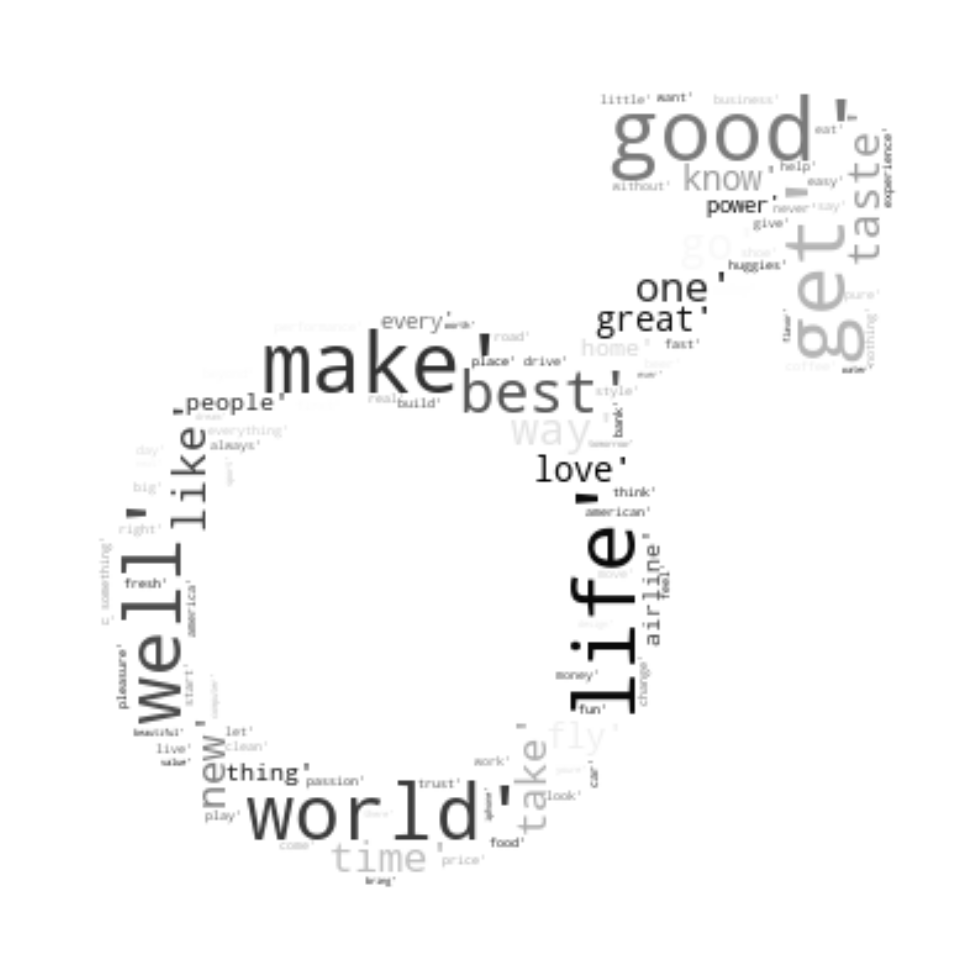

In [121]:
from wordcloud import ImageColorGenerator
from PIL import Image

#color_func=similar_color_func
#contour_color='black', contour_width=1

#mask_colors = ImageColorGenerator(mask)

mask = np.array(Image.open('/Users/agieen/Downloads/AllWomen/_Final_Project/Images/Masks/male.jpg'))
wc = WordCloud(stopwords=STOPWORDS,
               mask=mask, background_color="white",
               max_words=2000, max_font_size=256,
               random_state=42, width=mask.shape[1],
               height=mask.shape[0], contour_color='black')
wc.generate(str(mostcommon_m))
plt.imshow(wc.recolor(colormap= 'gray_r', random_state=17), alpha=0.98)


plt.imshow(wc, interpolation="bilinear")


plt.axis('off')
plt.show();
wc.to_file('male_30_common2.png')

In [122]:
wordcloud = WordCloud(width=1600, height=800, background_color='white').generate(str(mostcommon_m))
fig = plt.figure(figsize=(50,30), facecolor='white')
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis('off')
plt.title('100 Most Common Words in Companies Lead by MEN', fontsize=100)
plt.tight_layout(pad=0)
plt.show();

In [123]:
# plot with the most common words to see their frequency

mostcommon_part_m = FreqDist(allwords_m).most_common(30)
x, y = zip(*mostcommon_part_m)
plt.figure(figsize=(50,30))
plt.margins(0.02)
plt.barh(x, y)
plt.xlabel('Words', fontsize=40)
plt.ylabel('Frequency of Words', fontsize=40)
plt.yticks(fontsize=80)
plt.xticks(fontsize=60)
plt.title('30 Most Common Words and their Frequency (Companies Lead by MEN)', fontsize=100)
plt.show();

rotation=60,

In [124]:
mostcommon_part_m

[('good', 92),
 ('make', 76),
 ('life', 72),
 ('get', 68),
 ('world', 66),
 ('well', 65),
 ('best', 63),
 ('way', 55),
 ('go', 51),
 ('taste', 44),
 ('like', 40),
 ('time', 38),
 ('new', 38),
 ('take', 34),
 ('one', 33),
 ('great', 33),
 ('know', 32),
 ('love', 31),
 ('fly', 31),
 ('people', 30),
 ('thing', 30),
 ('home', 30),
 ('airline', 30),
 ('every', 29),
 ('power', 28),
 ('everything', 28),
 ('work', 28),
 ('car', 28),
 ('live', 28),
 ('right', 27)]

In [ ]:
#words_male_df = pd.DataFrame(mostcommon_part_m,columns=['Word','Count'])
#print (words_male_df)

In [ ]:
#words_male_dff = words_male_df.to_csv('words_male_df.csv')

#### Women

In [125]:
words_f = df_female['lemmatized']
allwords_f = []
for wordlist in words_f:
    allwords_f += wordlist

In [126]:

mostcommon_f = FreqDist(allwords_f).most_common(100)

In [127]:
# info cell - zeby zmienic i dodac stopwords


stopwords = set(STOPWORDS)
stopwords.add("said")

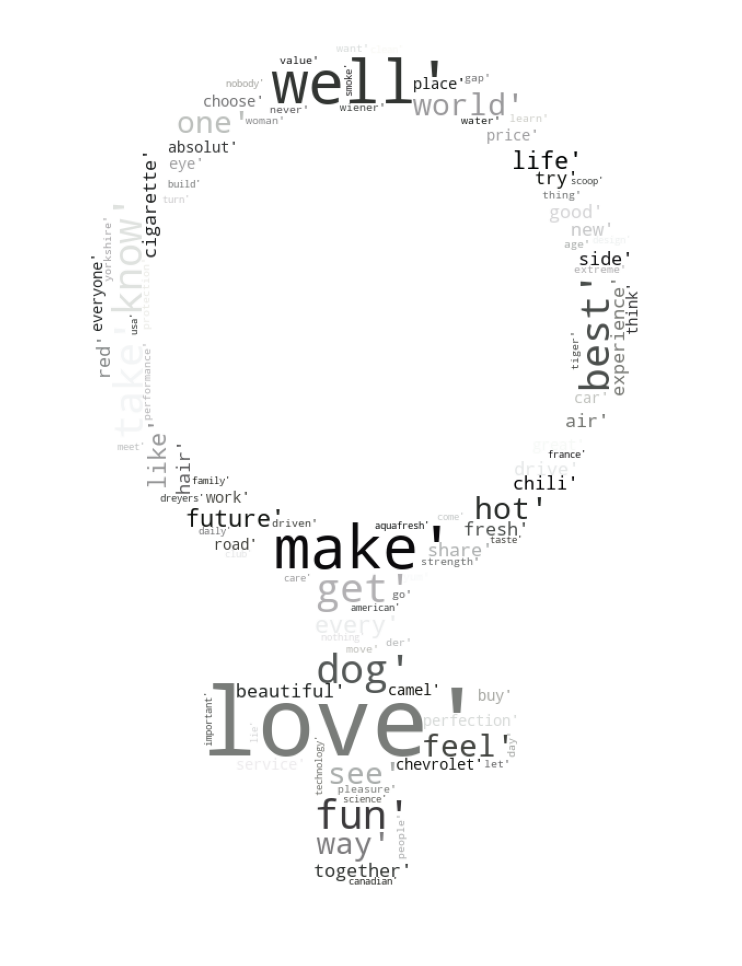

In [128]:
mask = np.array(Image.open('/Users/agieen/Downloads/AllWomen/_Final_Project/Images/Masks/female.jpg'))

wc = WordCloud(stopwords=STOPWORDS,
               mask=mask, background_color="white",
               max_words=2000, max_font_size=256,
               random_state=42, width=mask.shape[1],
               height=mask.shape[0], contour_color='black')
wc.generate(str(mostcommon_f))
plt.imshow(wc, interpolation="bilinear")
plt.imshow(wc.recolor(colormap= 'gray_r', random_state=17), alpha=0.98)


plt.axis('off')
plt.show();
#wc.to_file('female_30_common.png')

In [129]:
# plot with the most common words to see their frequency

mostcommon_part_f = FreqDist(allwords_f).most_common(30)
x, y = zip(*mostcommon_part_f)
plt.figure(figsize=(50,30))
plt.margins(0.02)
plt.barh(x, y)
plt.xlabel('Words', fontsize=60)
plt.ylabel('Frequency of Words', fontsize=60)
plt.yticks(fontsize=50)
plt.xticks(fontsize=60)
plt.title('30 Most Common Words and their Frequency (Companies Lead by WOMEN)', fontsize=100)
plt.show();

In [130]:
female_words_df = pd.DataFrame(mostcommon_part_f, columns=['Word','Count'])
words_female_dff = female_words_df.to_csv('words_female_df.csv')



<h2>So, what can we tell about those words? Are there any differences?<span class="tocSkip"></span></h2>



Well, if we look at the companies lead by Male CEOs, we can see words like power, car, drive, take, know. They seem to be connected with strenght, power, money.

In case of the companies with female CEOs, we notice words like love, feel, beautiful. They are lighter and more frivolous, connected with emotions.
